In [1]:
import os
import os.path as osp
import pickle

import torch 
import torch.nn as nn
import clip
import sklearn
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
from IPython.display import clear_output
from  torchvision import transforms as T
from sklearn.metrics import confusion_matrix

from emotionpredictor.training import SLP
import emotionpredictor.data_tools as dt
from emotionpredictor.visual import save_fig

%config InlineBackend.figure_format ='retina'

In [2]:
device = "cuda" if torch.cuda.is_available() else "cpu"

<b>Download the images</b>

1. You can download the test set required for visualisation at this [link](https://www.dropbox.com/s/ybn5l1rhx4zzyuy/test_set_artemis_224.zip?dl=0).

2. Unzip the file, and put the corresponding path in <code>img_folder_path</code> variable of the next cell.


In [13]:
#paths
clip_architecture = "RN50x16"
MODEL_PATH = f"""../neural_checkpoints/C-{clip_architecture.replace("/", "")}""" #Replace for ViTs models 
img_folder_path = "../data/test_set_artemis_224/"
assert osp.exists(img_folder_path), f"Folder does not exists {img_folder_path}"
preprocess_images = False # Set to True if the images are not preprocessed (.jpeg or .png for example)


In [5]:
ARTEMIS_EMOTIONS = ['amusement',
 'awe',
 'contentment',
 'excitement',
 'anger',
 'disgust',
 'fear',
 'sadness',
 'something else']

In [6]:
state_dict = torch.load(MODEL_PATH, map_location=device)
output_size, input_size = tuple((state_dict["layers.1.weight"].shape))
model = SLP(input_size=input_size, output_size=output_size)
model.load_state_dict(state_dict)
model.eval();

## Get direction for each emotion

### Wikiart dataloader

In [15]:
class ModelSLP(nn.Module):
    def __init__(self, slp, backbone, preprocess = None):
        super().__init__()
        self.slp = slp
        self.backbone = backbone
        self.preprocess = preprocess
        
    def forward(self, x):
        x = self.backbone(x)
        fp = self.slp(x)
        return fp.softmax()
    

In [17]:
backbone, preprocess = clip.load(clip_architecture)


In [22]:
pipeline = ModelSLP(slp=model,
                    backbone=backbone.encode_image,
                   preprocess = preprocess if preprocess_images else None)

# Simple prediction on images

# Prediction on text


In [30]:
!python ../emotionpredictor/demo_text.py

/Users/robin/Documents/Master_thesis/EmotionPredictor/notebooks/../emotionpredictor/demo_text.py:2: UserWarning: 
The dash_core_components package is deprecated. Please replace
`import dash_core_components as dcc` with `from dash import dcc`
  import dash_core_components as dcc
/Users/robin/Documents/Master_thesis/EmotionPredictor/notebooks/../emotionpredictor/demo_text.py:3: UserWarning: 
The dash_html_components package is deprecated. Please replace
`import dash_html_components as html` with `from dash import html`
  import dash_html_components as html
Dash is running on http://127.0.0.1:8049/

 * Serving Flask app 'demo_text' (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on
Traceback (most recent call last):
  File "/Users/robin/Documents/Master_thesis/EmotionPredictor/notebooks/../emotionpredictor/demo_text.py", line 120, in <module>
    app.run_server(debug=True, port = 8049)
  File "/Users/robin/miniconda3/lib/python3.9/site-pac

# Web interface !


In [23]:
image_loader = dt.Pickle_data_loader(img_folder_path)

In [ ]:
dataset = torch.tensor([]).to(device)
with torch.no_grad():
    for x in tqdm(image_loader):
        dataset = torch.cat([dataset, pipeline(x["image"])])
dataset.shape

In [62]:
emo_dataset = model(dataset)#.detach().cpu().numpy()
emo_dataset_sm = emo_dataset.softmax(1).detach().cpu().numpy()
emo_dataset_sm


array([[0.06392644, 0.09534592, 0.5460538 , ..., 0.01357988, 0.11402936,
        0.10578529],
       [0.01752037, 0.16499136, 0.6974882 , ..., 0.00660424, 0.0142414 ,
        0.02680298],
       [0.1015145 , 0.17138602, 0.40740842, ..., 0.04422021, 0.13498884,
        0.08034475],
       ...,
       [0.24228933, 0.1832186 , 0.08924715, ..., 0.12960555, 0.04464777,
        0.09296013],
       [0.17610665, 0.08893283, 0.07088219, ..., 0.37187773, 0.07436821,
        0.08655825],
       [0.05125291, 0.29128453, 0.088172  , ..., 0.07551577, 0.34730822,
        0.05174587]], dtype=float32)

In [64]:
emotion2index = dict(zip(ARTEMIS_EMOTIONS,list(range(9))))
def get_text_encoding(texts, text_encoder):
    text = clip.tokenize(texts).to(device)
    with torch.no_grad():
        text_features = text_encoder(text)
    return text_features

def mat(image_features, text_features, n_top = 20):
    image_features /= image_features.norm(dim=-1, keepdim=True)
    text_features /= text_features.norm(dim=-1, keepdim=True)
    similarity = (100.0 * image_features @ text_features.T).softmax(dim=0)
    #return similarity
    values, indices = similarity.T[0].topk(n_top)
    return values, indices

def show_images(indices, loader, batch_size = 40):
    fig, axes = plt.subplots(len(indices), figsize = (10,100))
    for i, indice in enumerate(indices):
        image = (loader.load_label(int(indice), batch_size))["image"]
        show_torch_image(image, axes[i])
    return

def to_pil(batch):
    transform = T.Compose([torchvision.transforms.ToPILImage()])
    batch["image"] = transform(batch["image"])
    return batch

In [115]:
def create_call_back(text_encoder, emotion_encoder, dataset, image_loader, n_text = 20, n_display = 2):
    @torch.no_grad()
    def call_back(emotion, text):
        text_features = get_text_encoding([text], text_encoder)
        val, indices = mat(dataset.cpu().float(), text_features.cpu().float(), n_top=n_text)
        matches = dataset[indices]

        emotion_score = emotion_encoder(matches)
        emotion_score = emotion_score.softmax(1)[:,emotion2index[emotion]].softmax(0).cpu()
        emotion_score = torch.stack([emotion_score, indices], dim=1)
        values, indices = emotion_score.T[0].topk(n_display)
        indices = emotion_score.T[1,indices]
        return indices
        output = [T.ToPILImage()(normalize(image_loader.load_label(int(indice), 40)["image"])) for indice in indices]
        #for indice in indices :
         #   b = show_torch_image(loader.load_label(int(indice))["image"])
         #   output.append(b)
        return tuple(output[:n_display])
        show_images(indices, loader)
        return plt.gcf()
    return call_back

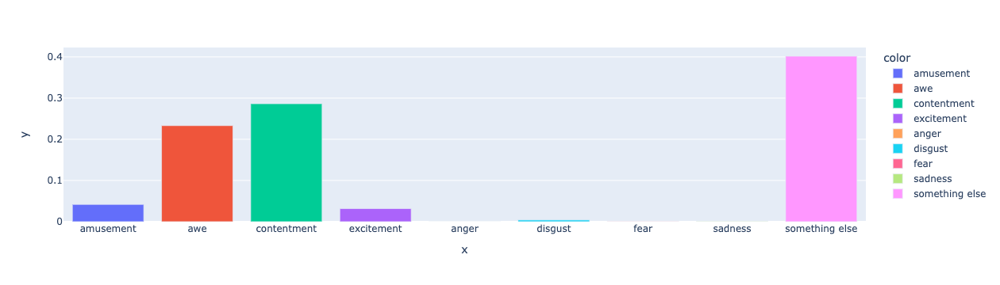

In [127]:
text = ""
text_features = get_text_encoding([text], RNx16.encode_text)
px.bar(y = model(text_features).softmax(1).tolist()[0], x = ARTEMIS_EMOTIONS, color = ARTEMIS_EMOTIONS)

<Figure size 432x288 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

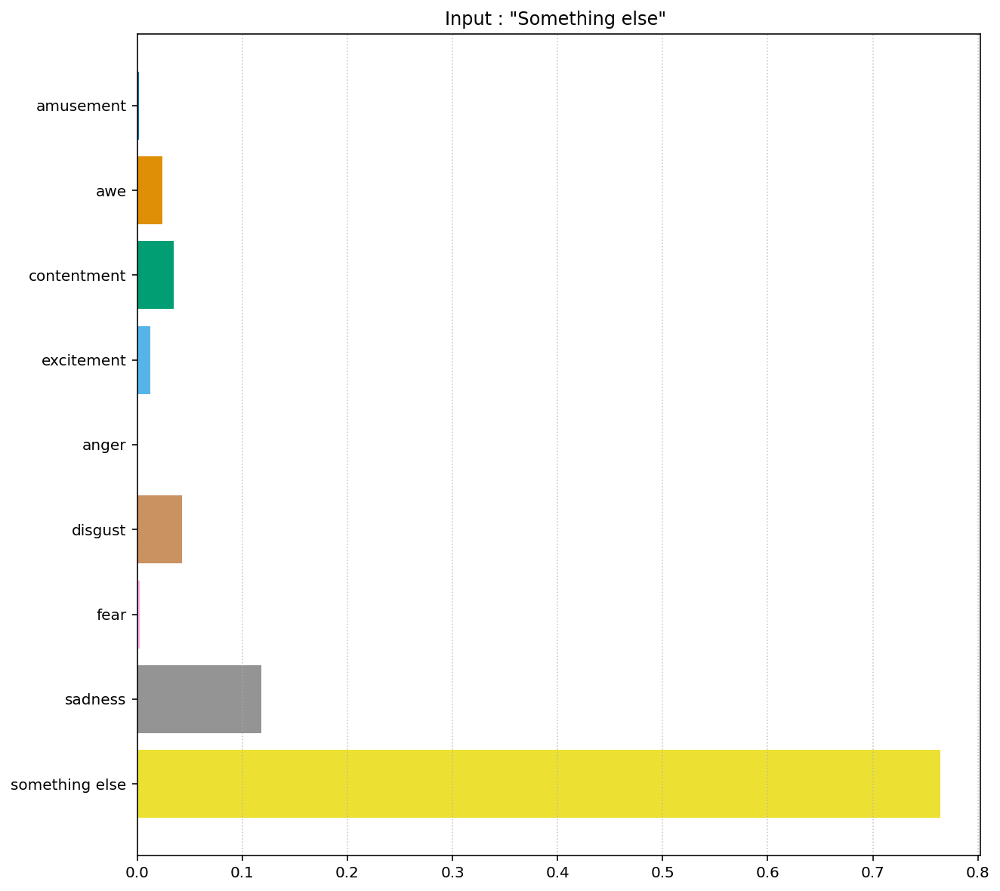

In [108]:
text = "fear"
def plot_text(text):
    text_features = get_text_encoding([text], RNx16.encode_text)
    ax = plt.barh(width=list(reversed(model(text_features).softmax(1).tolist()[0])),
                  y= list(reversed(ARTEMIS_EMOTIONS)),
                  color = list(reversed(visual.emotion_colors()[:9])))
    
for text in ARTEMIS_EMOTIONS:
    plt.clf()
    #visual.standardized_fig()
    plt.figure(figsize=(10,10))
    plot_text(text)
    plt.grid(axis = "x", ls = ":", alpha = 0.7)
    plt.title(f"""Input : "{text.capitalize()}" """);
    #save_fig(f"../results/text_relation/{text}.pdf")
    


Text(0.5, 1.0, 'Input : Rap')

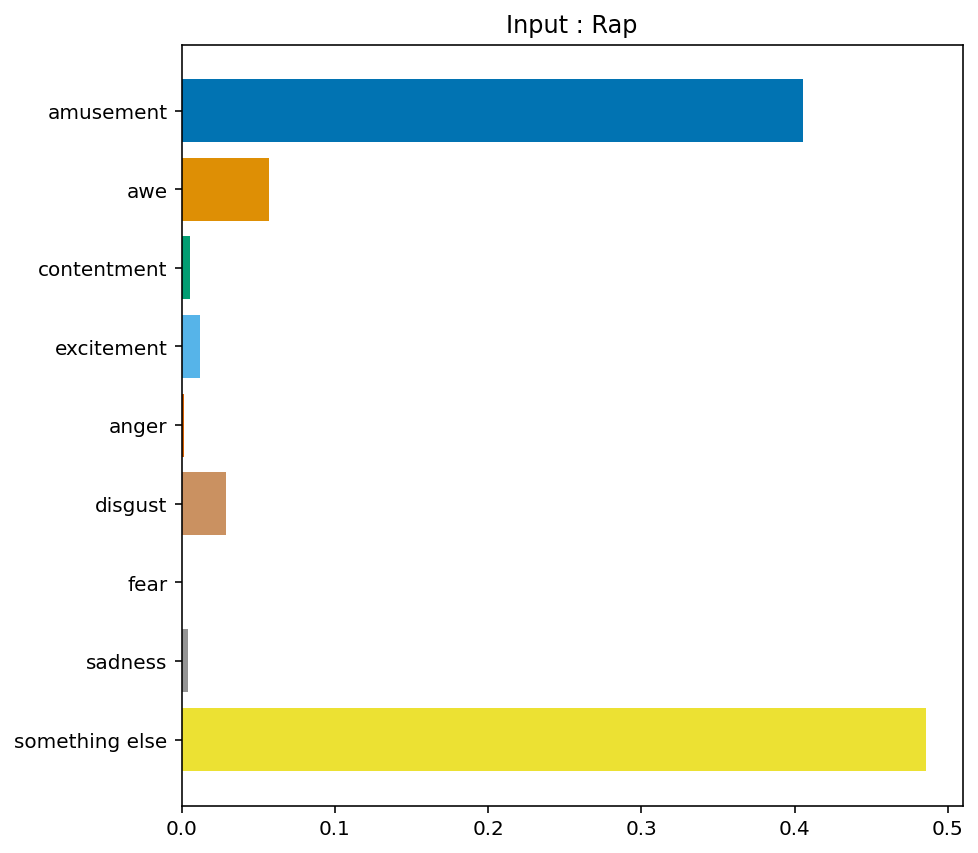

In [113]:
#visual.standardized_fig()
plt.figure(figsize = (7,7))
text = "rap"
plot_text(text)#get_text_encoding
plt.title(f"Input : {text.capitalize()}")
#save_fig("../results/text_relation/cucumber.pdf")

Text(0.5, 1.0, 'Input : Obama')

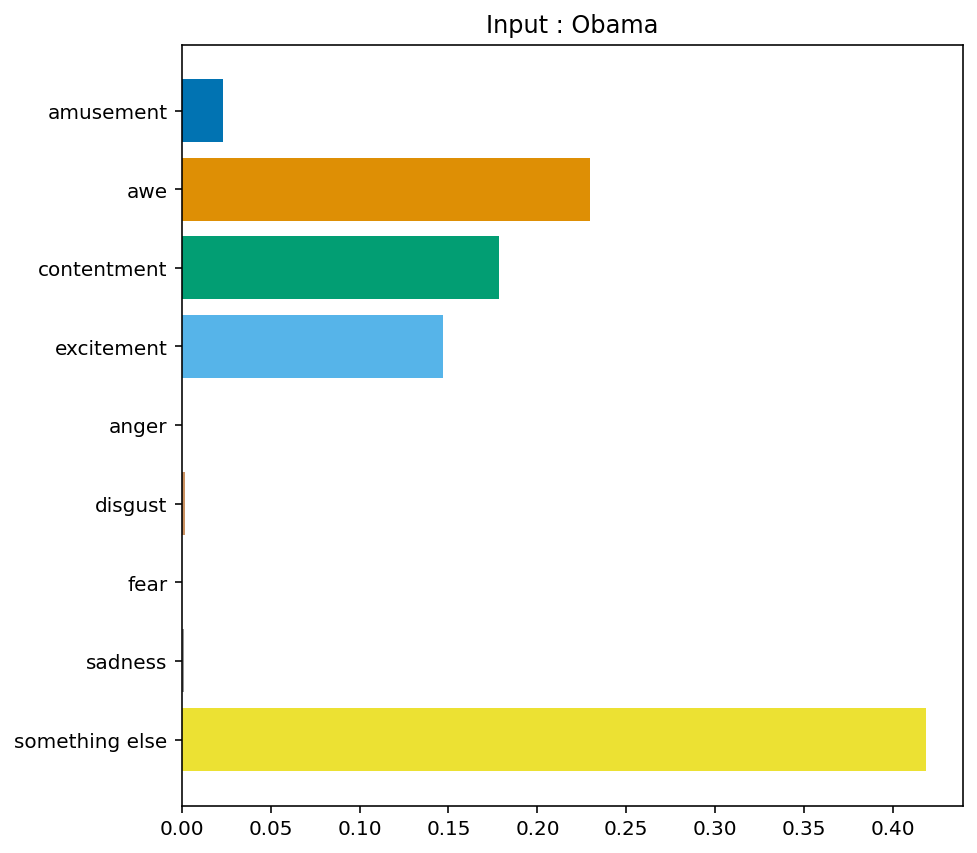

In [124]:
#visual.standardized_fig()
plt.figure(figsize = (7,7))
text = "Obama"
plot_text(text)#get_text_encoding
plt.title(f"Input : {text.capitalize()}")

In [112]:
func = create_call_back(text_encoder=RNx16.encode_text,
                        dataset=dataset,
                       emotion_encoder = model,
                        image_loader = image_loader,
                        n_text=200,
                       n_display = 2)

In [116]:
for emotion in ARTEMIS_EMOTIONS:
    print(emotion)
    imgs = func(emotion, "T-shirt")
    for img in imgs : 
        display(img)

amusement


tensor(3203., grad_fn=<UnbindBackward>)

tensor(3845., grad_fn=<UnbindBackward>)

awe


tensor(4317., grad_fn=<UnbindBackward>)

tensor(5775., grad_fn=<UnbindBackward>)

contentment


tensor(4039., grad_fn=<UnbindBackward>)

tensor(909., grad_fn=<UnbindBackward>)

excitement


tensor(5451., grad_fn=<UnbindBackward>)

tensor(2493., grad_fn=<UnbindBackward>)

anger


tensor(5937., grad_fn=<UnbindBackward>)

tensor(5206., grad_fn=<UnbindBackward>)

disgust


tensor(1201., grad_fn=<UnbindBackward>)

tensor(2567., grad_fn=<UnbindBackward>)

fear


tensor(1979., grad_fn=<UnbindBackward>)

tensor(1940., grad_fn=<UnbindBackward>)

sadness


tensor(5659., grad_fn=<UnbindBackward>)

tensor(2127., grad_fn=<UnbindBackward>)

something else


tensor(2956., grad_fn=<UnbindBackward>)

tensor(1433., grad_fn=<UnbindBackward>)

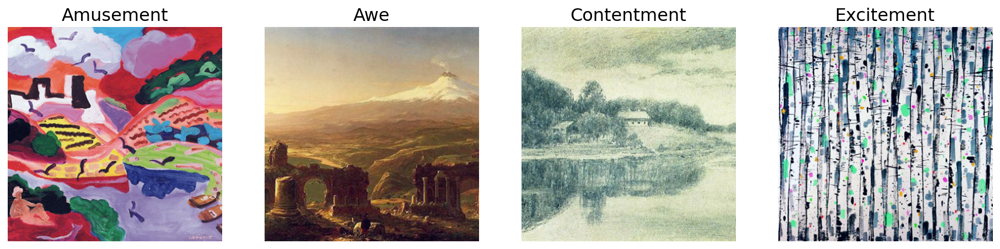

In [1901]:
fig, axs = plt.subplots(1,4,figsize = (16,9))
for i, emotion in enumerate(ARTEMIS_EMOTIONS[:4]):
    ax = axs[i]
    label = func(emotion, "landscape")[0].int().tolist()
    visual.show_torch_image(image_loader.load_label(label,40)["image"], ax )
    ax.set_title(emotion.capitalize(), fontsize=16 )
    
save_fig("../results/figures/birds_happy.pdf")

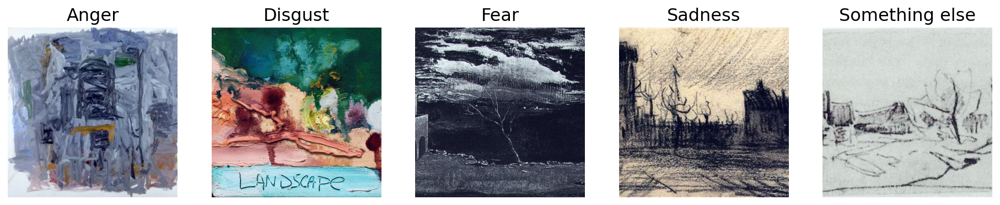

In [1900]:
fig, axs = plt.subplots(1,5,figsize = (16,9))
for i, emotion in enumerate(ARTEMIS_EMOTIONS[4:]):
    ax = axs[i]
    label = func(emotion, "landscape")[0].int().tolist()
    visual.show_torch_image(image_loader.load_label(label,40)["image"], ax )
    ax.set_title(emotion.capitalize(), fontsize=16 )
    
save_fig("../results/figures/birds_neg.pdf")

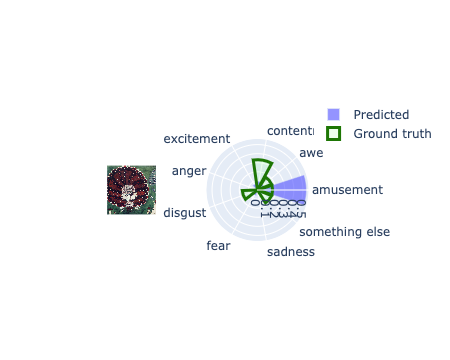

In [1829]:
with torch.no_grad():
    ids = func("amusement", "eagle").int().tolist()
    for i in ids:
        data = image_loader.load_label(i, 40)

        img = tensor2img(data["image"].detach().cpu())
        label = data["label"]
        pred = emo_dataset_sm[i]
        plot_img_pred_labels(img = img*10**6,
                             pred = pred,
                             gt = label.cpu().numpy(),
                             categories = ARTEMIS_EMOTIONS,
                        ).show()

In [109]:
import io 
from PIL import Image

def plotly_fig2array(fig):
    #convert Plotly fig to  an array
    fig_bytes = fig.to_image(format="png")
    buf = io.BytesIO(fig_bytes)
    img = Image.open(buf)
    return np.asarray(img)

def plot_img_pred_labels(img, pred, gt = None, categories = "infer", show = True, save_path = ""):
    if categories == "infer" : 
        categories = pred.index
        
    fig = go.Figure()
    fig = make_subplots(rows=1, cols=2, specs=[[{"type": "image"},{"type": "polar"}]])
    fig.add_trace(
        go.Image(z=normalize(img)*256, hoverinfo=None),
        row=1, col=1
    )
    fig.update_xaxes(showticklabels=False)
    fig.update_yaxes(showticklabels=False)
    

   
    fig.add_trace(go.Barpolar(
    base=0,
      r = pred,
      theta = categories,
      name = 'Predicted',
      marker_color = "rgba(77,77,255, 0.6)"

    ),   row=1, col=2)
    
    if gt is not None:
        fig.add_trace(go.Barpolar(
            base = 0,
              r = gt,
              theta = categories,
              name = 'Ground truth',
              marker_color="rgba(77,255,77,0.1)",
            marker_line_width=3,
            marker_line_color="rgba(29, 118, 4, 1)"

        ),  row=1, col=2)
    
    fig.update_layout(
      polar=dict(
        radialaxis=dict(
          visible=True,
        #  range=[0, 0.8]
        )),
      showlegend=True
    )


    #fig.update_layout(margin = dict(t=20, l=20, r=20, b=20))
    if bool(save_path):
        fig.write_image(save_path)
        
    if show : return fig
    return

In [110]:
for label in [2]:#range(200,205,1):
    categories = ARTEMIS_EMOTIONS

    pred = pd.Series(emo_dataset_sm[label], index=ARTEMIS_EMOTIONS)
    gt = image_loader.load_label(label,40)
    img = tensor2img(gt["image"])
    gt = pd.Series(gt["label"].detach().cpu().numpy(), index=ARTEMIS_EMOTIONS)

    #plot_img_pred_labels(img, pred = pred, gt = gt, save_path = f"../results/examples/label{label}.pdf", show = True)
    plot_img_pred_labels(img.detach().cpu(), pred = pred, gt=gt, show = True).show()   

NameError: name 'make_subplots' is not defined

In [514]:
p = plot_img_pred_labels(img, pred = pred, gt=gt, show = True)    

In [502]:
from PIL import Image
Image(p.to_image())

TypeError: 'module' object is not callable

(-0.5, 699.5, 499.5, -0.5)

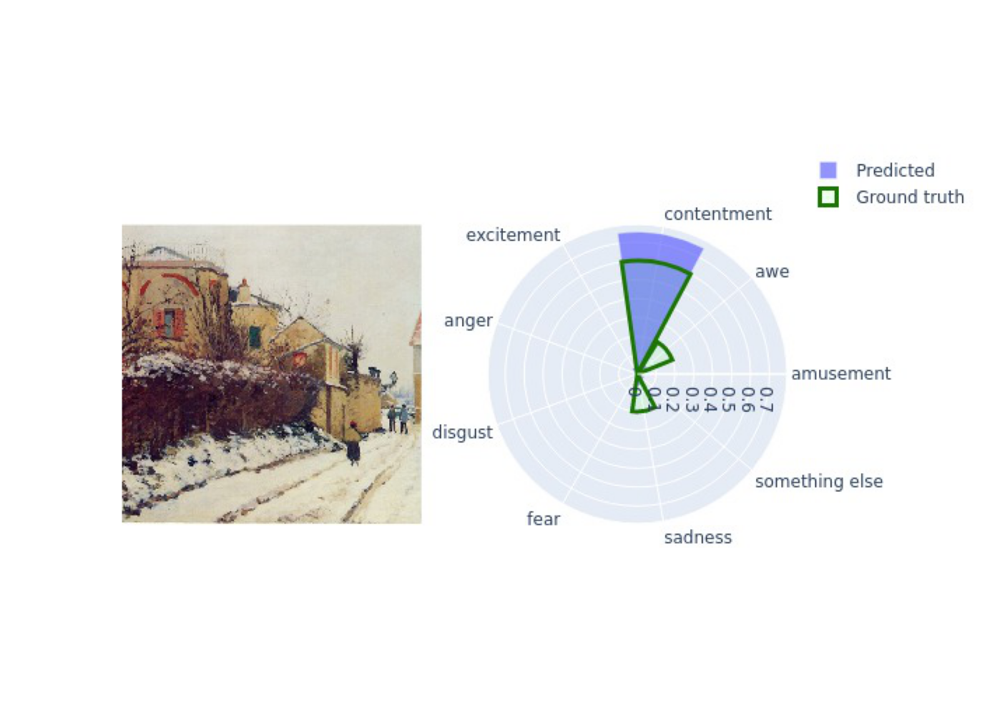

In [639]:
plt.figure(figsize = (16,9))
plt.imshow(plotly_fig2array(p))
plt.axis("off")

In [47]:
loader = dt.Pickle_data_loader("../data/wikiart_preprocessed_for_clip_RN50x16/test/")

In [262]:
from visual import save_fig

In [49]:
def create_interface():
    iface = gr.Interface(call_back, 
        [gr.inputs.Radio(ARTEMIS_EMOTIONS), "text"],
        ["image"]*2,
        examples=[
            ["awe", "king"],
            ["fear", "king"],
            ["fear", "death"],
            ["amusement", "death"],
        ],
        title="Model test",
        description="Here's a wikiart beta exploration tool !",
    )
    iface.launch(share=True)

In [50]:
create_interface()

Running on local URL:  http://127.0.0.1:7864/
Running on public URL: https://17573.gradio.app

This share link expires in 72 hours. For free permanent hosting, check out Spaces (https://huggingface.co/spaces)


In [375]:
import numpy as np

## Text visualisation

In [1515]:
text = ["cat", "dog"]
text_features = get_text_encoding(text, RNx16.encode_text)
emo_text = model(text_features).softmax(1).tolist()#[0]
#df = pd.DataFrame()
fig = px.scatter(pd.DataFrame(emo_text).T[0], text=emo_text[0]  )
fig.update_traces()scatter(pd.DataFrame(emo_text).T[1], text=emo_text[0]  )
#fig = px.scatter(df, x=df.columns, y=df, text= df.index, size_max=60)

#fig.update_traces(textposition='top center')

AttributeError: 'Figure' object has no attribute 'scatter'

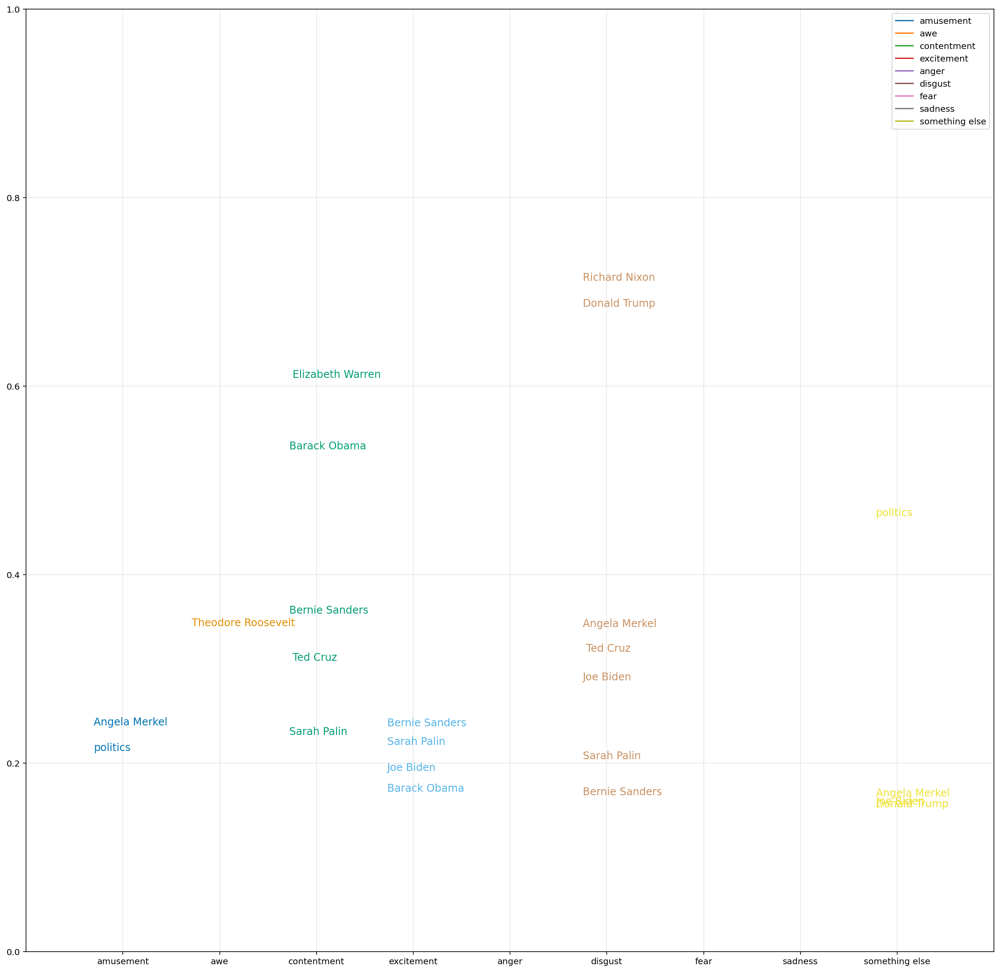

In [1704]:
text = ["cat", "dog", "trump", "obama", "chair", "Joe biden", "Republicans", "Democrats", "politics", "musk", "Bezos"] \
   + "Cartoons, fun,round, fat, obese, cheese, cucumber, cherry, cake, candy".split(",")\
    + " Majestic religious icons cathedral angel".split()\
    + "Vivid movement action".split()

#   + "Gardens calm green forests rivers ponds".split()\ 
text = list(c.values())[:2]+["US", "together", "united states"]
text = "Joe Biden,Bernie Sanders, Elizabeth Warren".split(",") + ",Angela Merkel,Sarah Palin,Theodore Roosevelt,Richard Nixon,Barack Obama,Donald Trump, Ted Cruz".split(",") +["politics"]
text_features = get_text_encoding(text, RNx16.encode_text)
emo_text = model(text_features).softmax(1).tolist()

plt.figure(figsize = (20,20))
for scores, text in zip(emo_text, text) :
    vs, ids = torch.topk(torch.tensor(scores), 3)
    for v, i in zip(vs,ids):
        if v<0.15: continue
        x = i.tolist() 
        y = v.tolist()
        plt.plot(x , y, )
        plt.text(x * (1 + 0.01)+0.7 , y * (1 + 0.01) , text, color=visual.emotion_colors()[x],  fontsize=12)

plt.ylim(0,1)
plt.xlim(0,10)
plt.grid(alpha = 0.3)
#plt.ylim((0, 1))
plt.xticks(range(1,10), ARTEMIS_EMOTIONS);
plt.legend(ARTEMIS_EMOTIONS)
save_fig("../results/text_relation/politicians.pdf")

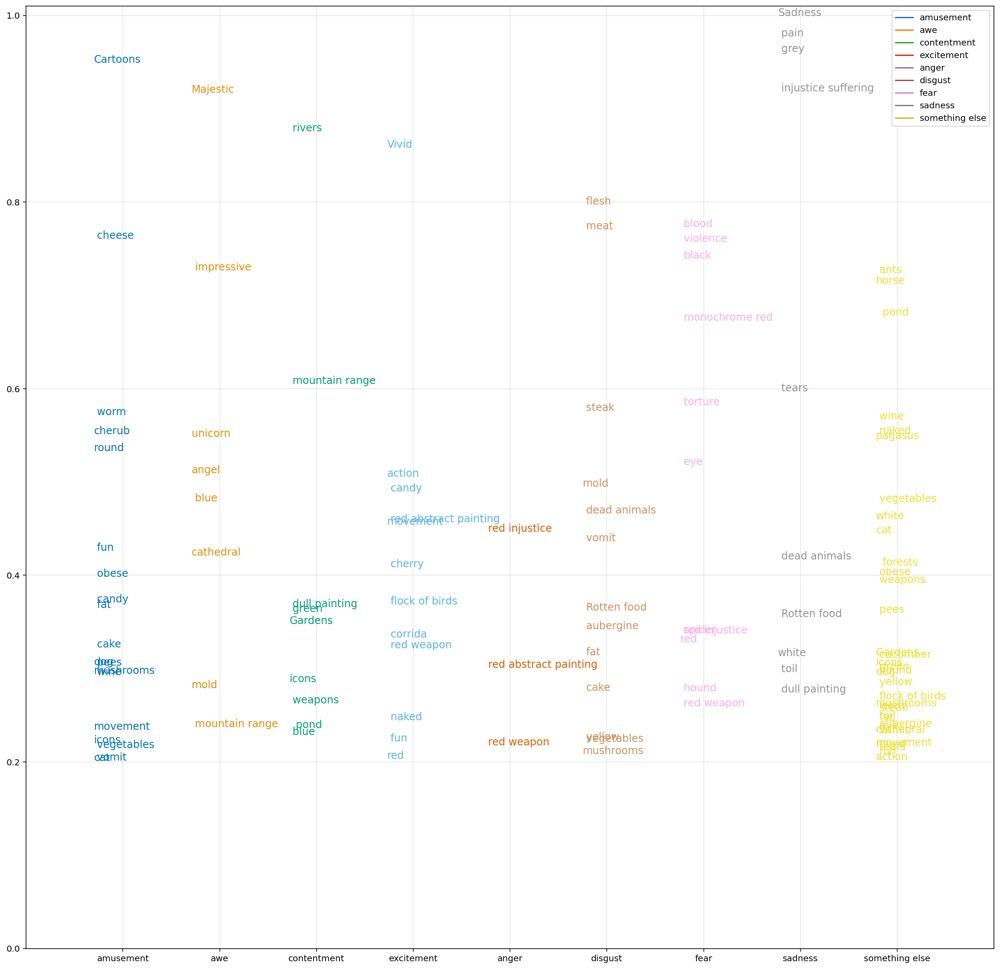

In [1761]:
text = ["cat", "dog", ] \
   + "Cartoons, fun,round, fat, obese, cheese, cucumber, cherry, cake, candy".split(",")\
    + " Majestic icons cathedral angel cherub horse unicorn pagasus".split()\
    + "Vivid movement action".split()\
    + "red, torture, injustice suffering, dull painting, monochrome red, violence, weapons".split(",")\
    + " Rotten food, dead animals, aubergine, naked, flesh, blood, hound, pain, red injustice".split(",")\
    + "Sadness, tears, toil, impressive".split(",")\
    + "white, blue, green, yellow, grey, black".split(",")\
    + "Gardens,  forests, rivers,  pond, mountain range, flock of birds".split(",")\
    + "mushrooms, pees, vegetables, meat, steak, wine".split(",")\
    + "mold, eye, worm, spider, ants, vomit, red weapon, corrida, red abstract painting".split(",")

    

#   + "Gardens calm green forests rivers ponds".split()\ 
text_features = get_text_encoding(text, RNx16.encode_text)
emo_text = model(text_features).softmax(1).tolist()

plt.figure(figsize = (20,20))
for scores, text in zip(emo_text, text) :
    vs, ids = torch.topk(torch.tensor(scores), 3)
    for v, i in zip(vs,ids):
        if v<0.2: continue
        x = i.tolist() 
        y = v.tolist()
        plt.plot(x , y, )
        plt.text(x * (1 + 0.01)+0.7 , y * (1) , text, color=visual.emotion_colors()[x],  fontsize=12)

plt.ylim(0,1.01)
plt.xlim(0,10)
plt.grid(alpha = 0.3)
#plt.ylim((0, 1))
plt.xticks(range(1,10), ARTEMIS_EMOTIONS);
plt.legend(ARTEMIS_EMOTIONS)
save_fig("../results/text_relation/emotions.pdf")

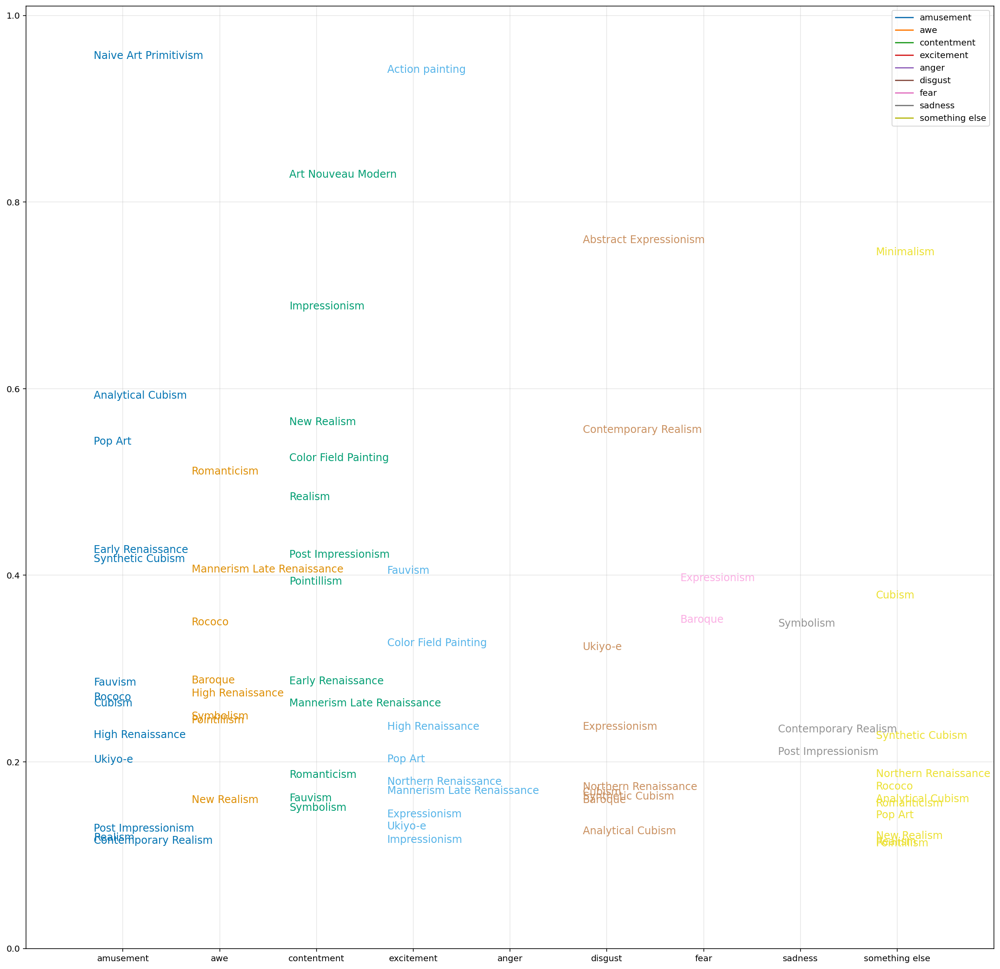

In [1818]:
text = ['Abstract Expressionism', 'Action painting', 'Analytical Cubism',
       'Art Nouveau Modern', 'Baroque', 'Color Field Painting',
       'Contemporary Realism', 'Cubism', 'Early Renaissance',
       'Expressionism', 'Fauvism', 'High Renaissance', 'Impressionism',
       'Mannerism Late Renaissance', 'Minimalism',
       'Naive Art Primitivism', 'New Realism', 'Northern Renaissance',
       'Pointillism', 'Pop Art', 'Post Impressionism', 'Realism',
       'Rococo', 'Romanticism', 'Symbolism', 'Synthetic Cubism',
       'Ukiyo-e']

text_features = get_text_encoding(text, RNx16.encode_text)
emo_text = model(text_features).softmax(1).tolist()

plt.figure(figsize = (20,20))
for scores, text in zip(emo_text, text) :
    vs, ids = torch.topk(torch.tensor(scores), 3)
    for v, i in zip(vs,ids):
        if v<0.1: continue
        x = i.tolist() 
        y = v.tolist()
        plt.plot(x , y, )
        plt.text(x * (1 + 0.01)+0.7 , y * (1) , text, color=visual.emotion_colors()[x],  fontsize=12)

plt.ylim(0,1.01)
plt.xlim(0,10)
plt.grid(alpha = 0.3)
#plt.ylim((0, 1))
plt.xticks(range(1,10), ARTEMIS_EMOTIONS);
plt.legend(ARTEMIS_EMOTIONS)
save_fig("../results/text_relation/art_style_pred.pdf")